In [1]:
#%matplotlib notebook
#%matplotlib inline

%load_ext autoreload
%autoreload 2

import cv2 
import matplotlib.pyplot as plt
import numpy as np
from cv2 import cv2

import ModelsConfiguration as config

models = config.GetModelsConfigured()

#### Brute Force Matches Without Crosscheck

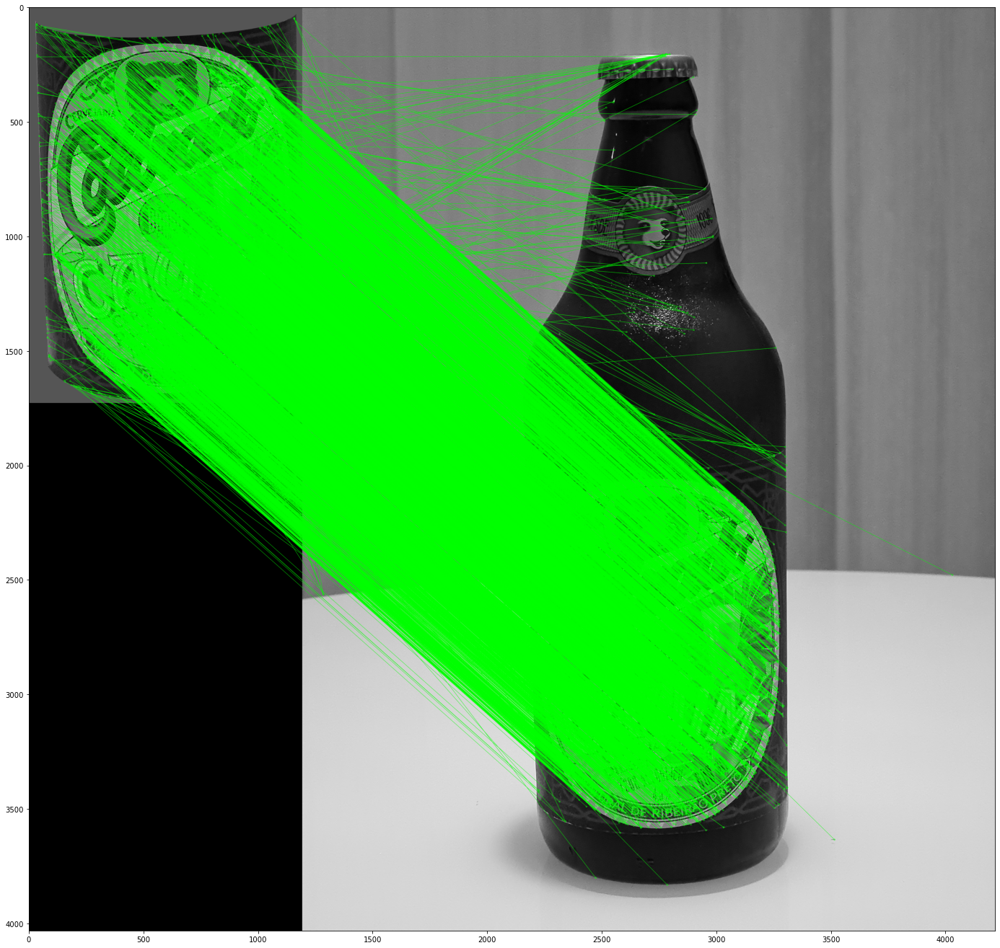

In [2]:
p_TwoSidesCheck = False

# read images
label = cv2.imread('.\\images\\Models\\' + models[0]['Name'] + '\\' + models[0]['Label']['Images'][0])
img_scene = cv2.imread('.\\images\\Models\\' + models[0]['Name'] + '\\OK\\' +  models[0]['OK']['Images'][0])

label = cv2.cvtColor(label, cv2.COLOR_BGR2GRAY)
img_scene = cv2.cvtColor(img_scene, cv2.COLOR_BGR2GRAY)

#sift
sift = cv2.SIFT_create()

keypoints_label, descriptors_label = sift.detectAndCompute(label, None)
keypoints_scene, descriptors_scene = sift.detectAndCompute(img_scene, None)

#feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=p_TwoSidesCheck)

matches = bf.match(descriptors_label, descriptors_scene)
matches_without_cc = sorted(matches, key = lambda x:x.distance)

img_result = cv2.drawMatches(label, keypoints_label, img_scene, keypoints_scene, 
                             matches_without_cc, img_scene, flags=2, matchColor=(0, 255, 0))
plt.figure(figsize=[24,24])
plt.imshow(img_result)

#### Brute Force Matches With Crosscheck

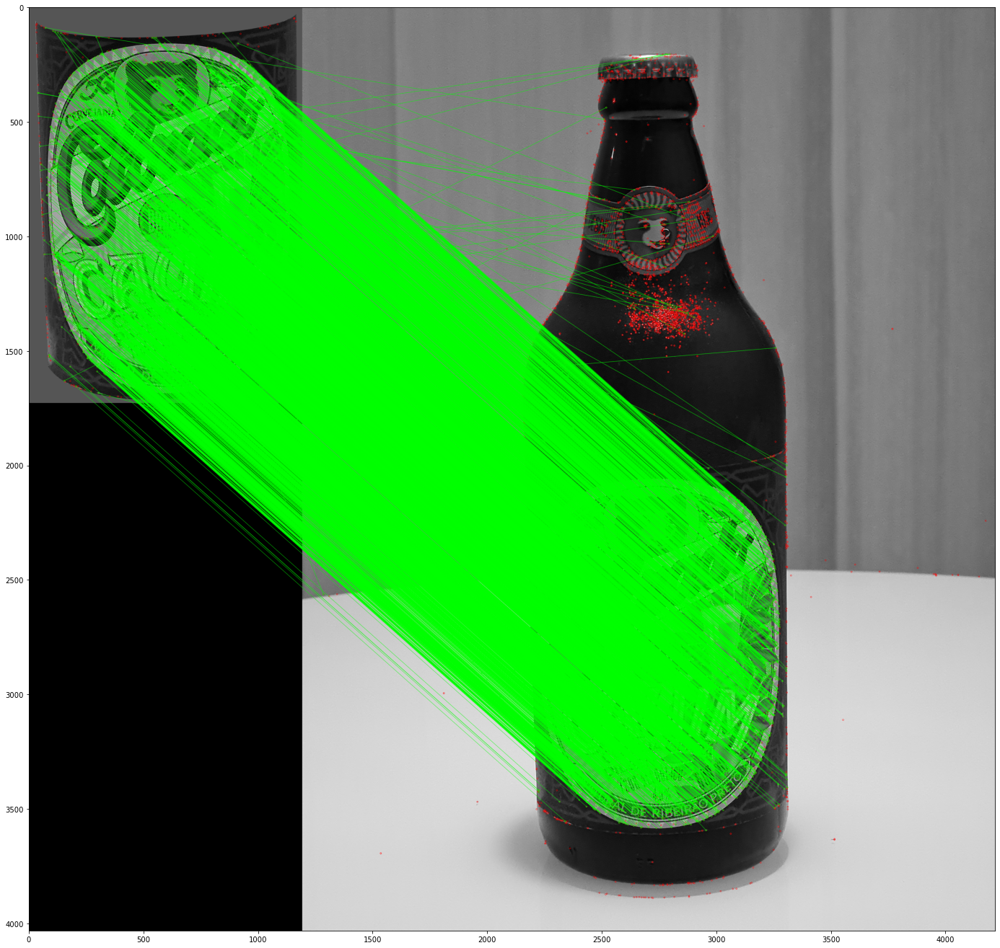

In [3]:
p_TwoSidesCheck = True

#feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=p_TwoSidesCheck)

matches = bf.match(descriptors_label, descriptors_scene)
matches_with_cc = sorted(matches, key = lambda x:x.distance)

img_result = cv2.drawMatches(label, keypoints_label, img_scene, keypoints_scene, 
                          matches_with_cc, None, matchColor=(0, 255, 0), matchesMask=None,
                          singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(img_result)

In [4]:
print('Matches Without Crosscheck: ' + str(len(matches_without_cc)))
print('Matches With Crosscheck: ' + str(len(matches_with_cc)))

Matches Without Crosscheck: 6740
Matches With Crosscheck: 6135


#### NG Images - Brute Force Matches Without Crosscheck

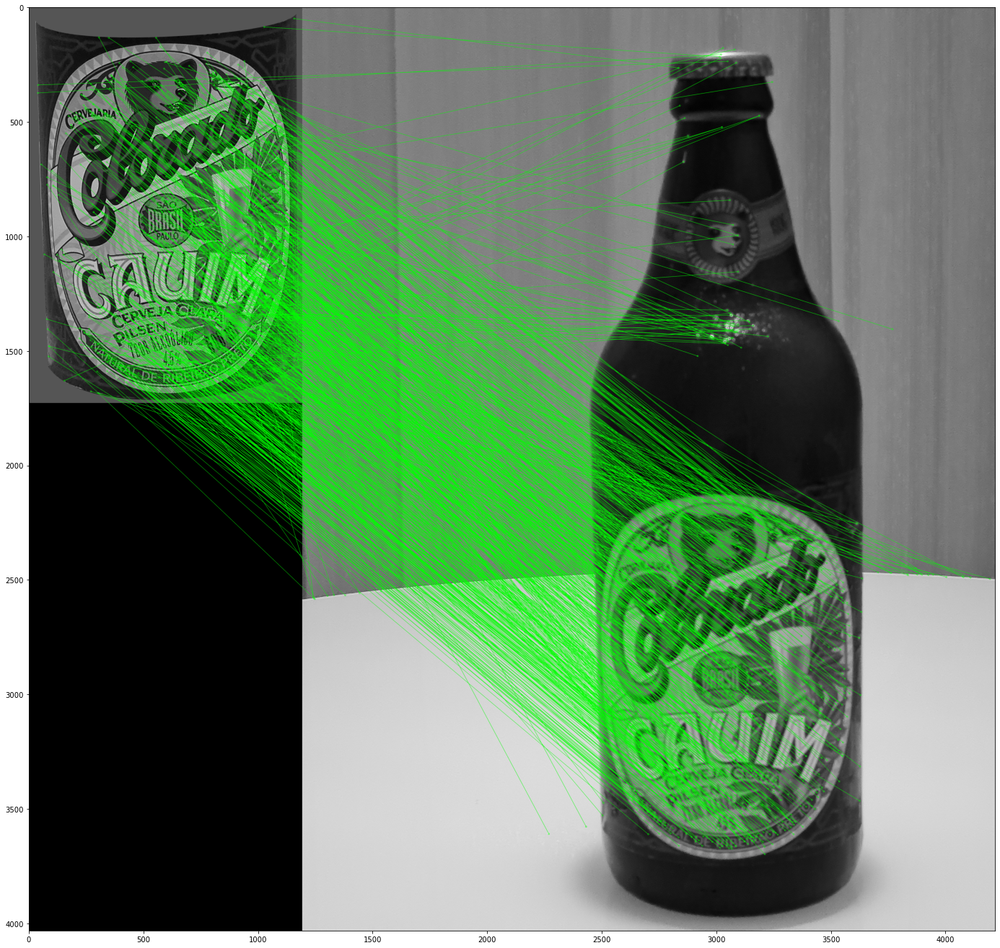

In [5]:
p_TwoSidesCheck = False

# read images
ng_img_scene = cv2.imread('.\\images\\Models\\' + models[0]['Name'] + '\\NG\\' +  models[0]['NG']['Images'][0])

ng_img_scene = cv2.cvtColor(ng_img_scene, cv2.COLOR_BGR2GRAY)

ng_keypoints_scene, ng_descriptors_scene = sift.detectAndCompute(ng_img_scene, None)

#feature matching
ng_matches = bf.match(descriptors_label, ng_descriptors_scene)
ng_matches_without_cc = sorted(ng_matches, key = lambda x:x.distance)

ng_img_result = cv2.drawMatches(label, keypoints_label, ng_img_scene, ng_keypoints_scene, 
                             ng_matches_without_cc, ng_img_scene, flags=2, matchColor=(0, 255, 0))
plt.figure(figsize=[24,24])
plt.imshow(ng_img_result)

#### NG Images - Brute Force Matches With Crosscheck

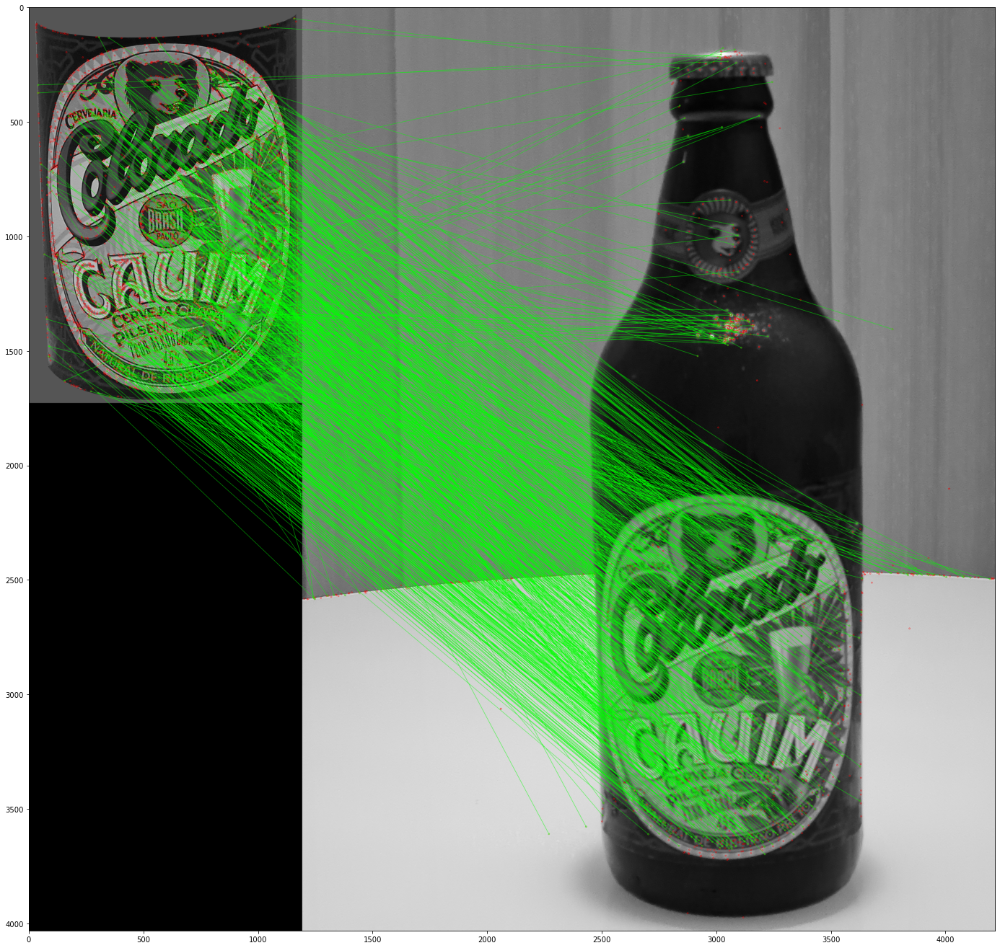

In [6]:
p_TwoSidesCheck = True

#feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=p_TwoSidesCheck)

ng_matches = bf.match(descriptors_label, ng_descriptors_scene)
ng_matches_with_cc = sorted(ng_matches, key = lambda x:x.distance)

ng_img_result = cv2.drawMatches(label, keypoints_label, ng_img_scene, ng_keypoints_scene, 
                                ng_matches_with_cc, None, matchColor=(0, 255, 0), matchesMask=None,
                                singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(ng_img_result)

In [7]:
print('Matches Without Crosscheck: ' + str(len(matches_without_cc)))
print('Matches With Crosscheck: ' + str(len(matches_with_cc)))

Matches Without Crosscheck: 6740
Matches With Crosscheck: 6135


#### Brute Force with KNN Without Crosscheck

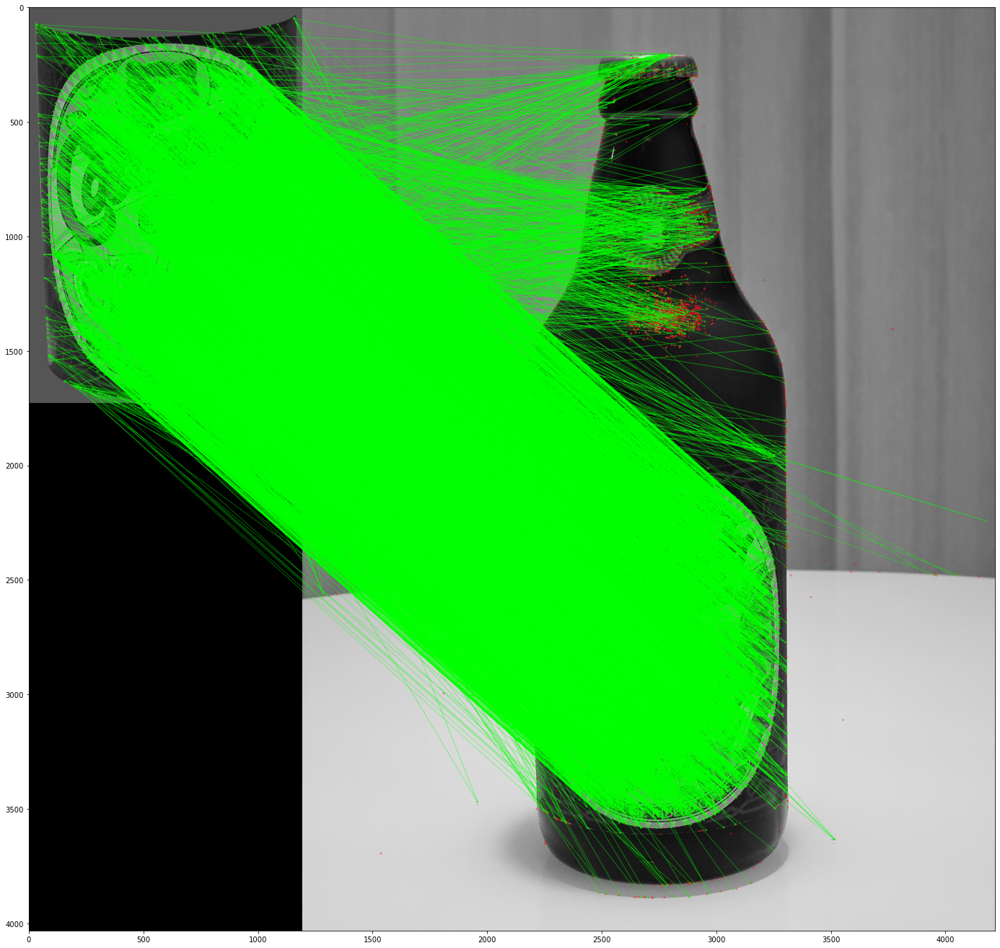

In [8]:
p_TwoSidesCheck = False

#KNN Finds for each descriptor this quantity
p_QuantitiesOfTheBestMatchings = 2

bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=p_TwoSidesCheck)

matches_knn_without_cc = bf.knnMatch(descriptors_label, descriptors_scene, k = p_QuantitiesOfTheBestMatchings)

img_result = cv2.drawMatchesKnn(label, keypoints_label, img_scene, keypoints_scene, 
                          matches_knn_without_cc, None, matchColor=(0, 255, 0), matchesMask=None,
                          singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(img_result)

#### NG Images - Brute Force with KNN Without Crosscheck

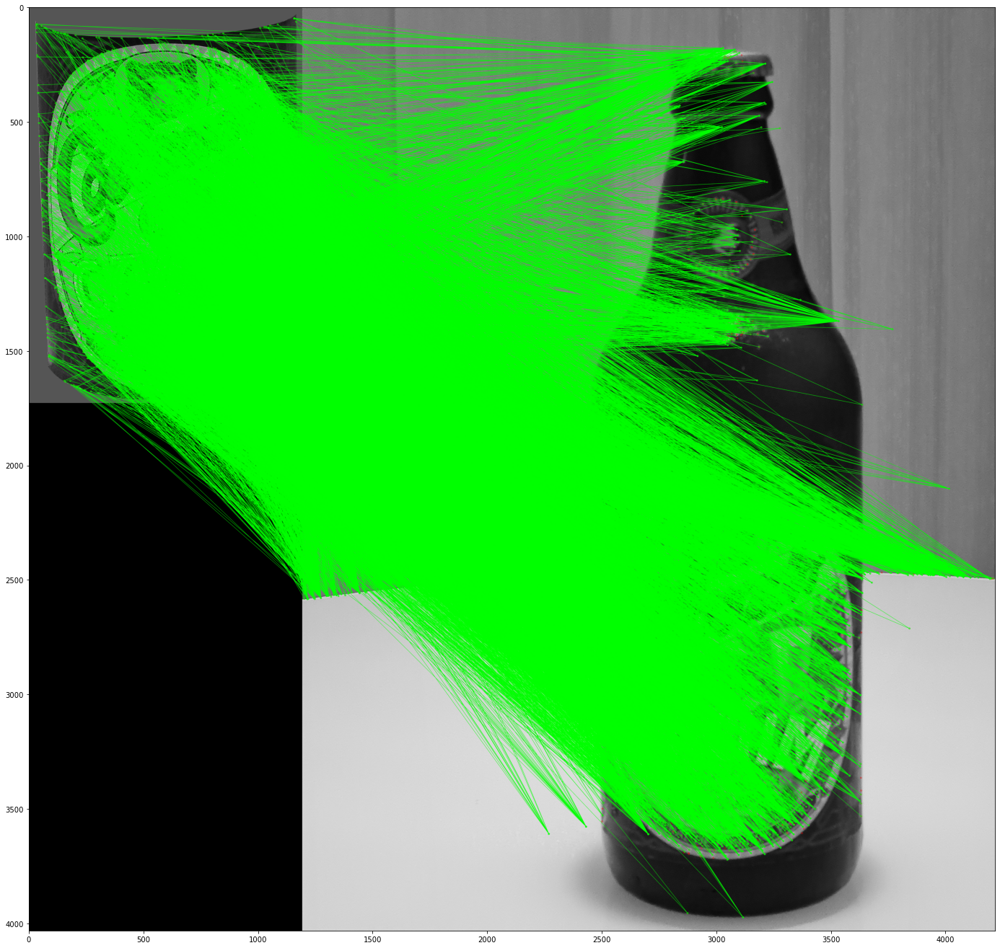

In [9]:
p_TwoSidesCheck = False

#KNN Finds for each descriptor this quantity
p_QuantitiesOfTheBestMatchings = 2

bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=p_TwoSidesCheck)

ng_matches_knn_without_cc = bf.knnMatch(descriptors_label, ng_descriptors_scene, k = p_QuantitiesOfTheBestMatchings)

ng_img_result = cv2.drawMatchesKnn(label, keypoints_label, ng_img_scene, ng_keypoints_scene, 
                                   ng_matches_knn_without_cc, None, matchColor=(0, 255, 0), matchesMask=None,
                                   singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(ng_img_result)

#### Brute Force with KNN Without Crosscheck and Filtering by distance between two best results

Without Good Distance: 6740
With Good Distance: 6030


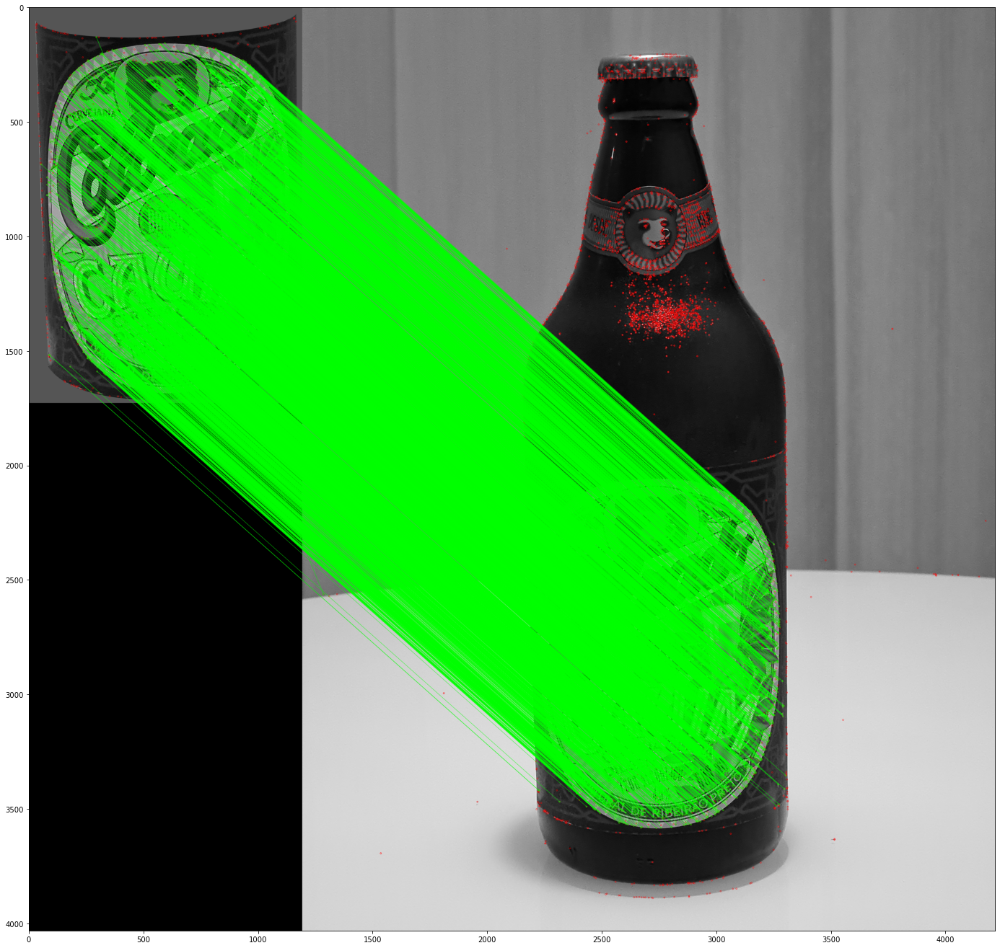

In [10]:
#Attention spected 2 values [m, n]
good_distance = [[m] for m, n in matches_knn_without_cc if m.distance < 0.6*n.distance]

img_result = cv2.drawMatchesKnn(label, keypoints_label, img_scene, keypoints_scene, 
                                good_distance, None, matchColor=(0, 255, 0), matchesMask=None,
                                singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(img_result)

print("Without Good Distance: " + str(len(matches_knn_without_cc)))
print("With Good Distance: " + str(len(good_distance)))

Without Good Distance: 6740
With Good Distance: 297


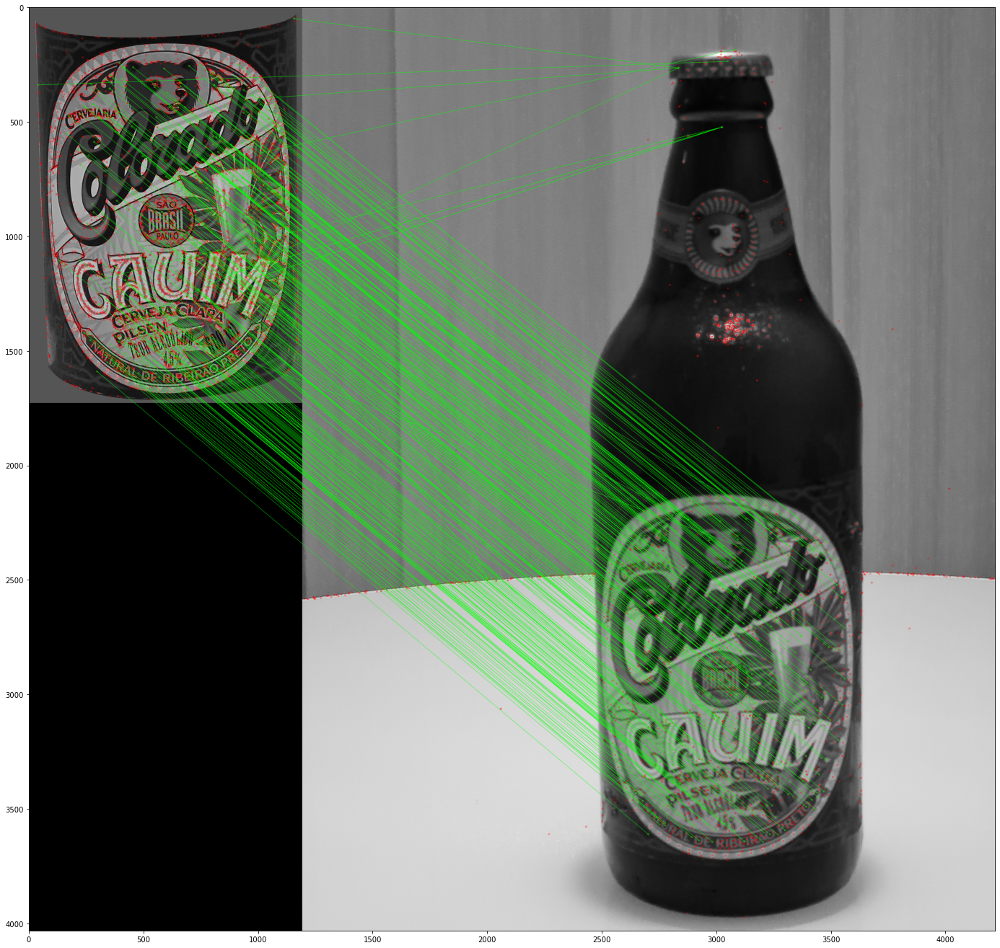

In [11]:
#Attention spected 2 values [m, n]
ng_good_distance = [[m] for m, n in ng_matches_knn_without_cc if m.distance < 0.6*n.distance]

ng_img_result = cv2.drawMatchesKnn(label, keypoints_label, ng_img_scene, ng_keypoints_scene, 
                                   ng_good_distance, None, matchColor=(0, 255, 0), matchesMask=None,
                                   singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(ng_img_result)

print("Without Good Distance: " + str(len(ng_matches_knn_without_cc)))
print("With Good Distance: " + str(len(ng_good_distance)))

#### Brute Force with KNN With Crosscheck

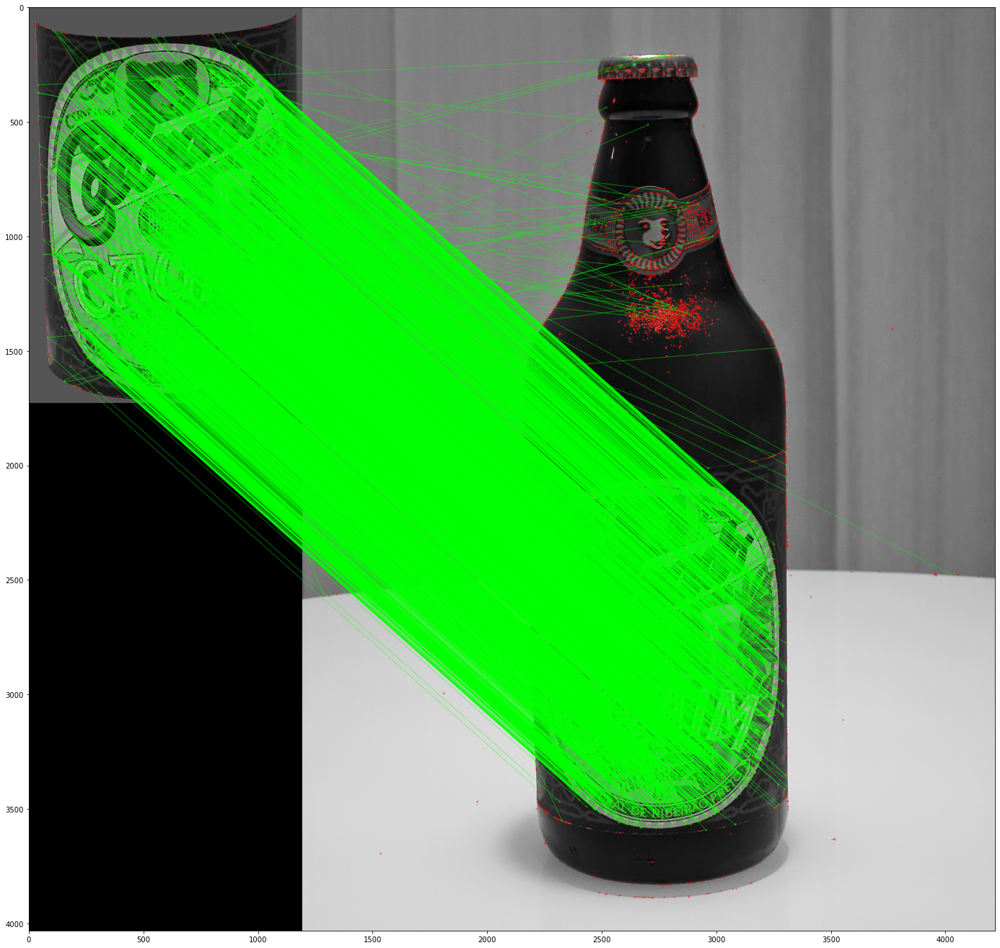

In [12]:
p_TwoSidesCheck = True

#With Crosscheck only one match is considered
p_QuantitiesOfTheBestMatchings = 1

matcher = cv2.BFMatcher(crossCheck = p_TwoSidesCheck)
matches_knn_with_cc = matcher.knnMatch(descriptors_label, descriptors_scene, k = p_QuantitiesOfTheBestMatchings)

img_result = cv2.drawMatchesKnn(label, keypoints_label, img_scene, keypoints_scene, 
                                matches_knn_with_cc, None, matchColor=(0, 255, 0), matchesMask=None,
                                singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(img_result)

#### Brute Force with KNN With Crosscheck

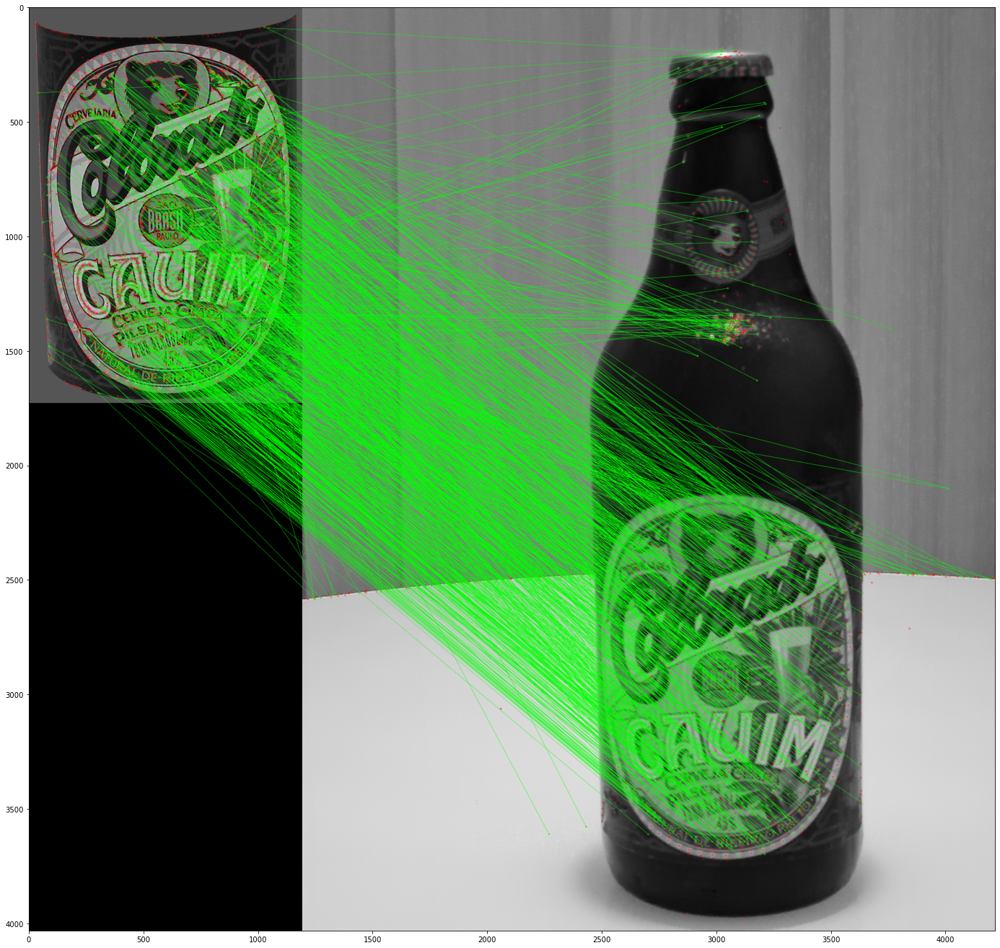

In [13]:
p_TwoSidesCheck = True

#With Crosscheck only one match is considered
p_QuantitiesOfTheBestMatchings = 1

matcher = cv2.BFMatcher(crossCheck = p_TwoSidesCheck)
ng_matches_knn_with_cc = matcher.knnMatch(descriptors_label, ng_descriptors_scene, k = p_QuantitiesOfTheBestMatchings)

ng_img_result = cv2.drawMatchesKnn(label, keypoints_label, ng_img_scene, ng_keypoints_scene, 
                                   ng_matches_knn_with_cc, None, matchColor=(0, 255, 0), matchesMask=None,
                                   singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(ng_img_result)

#### Brute Force with KNN With Crosscheck and Filtering by distance with max distance ratio

Without Good Distance: 6137
With Good Distance: 6100


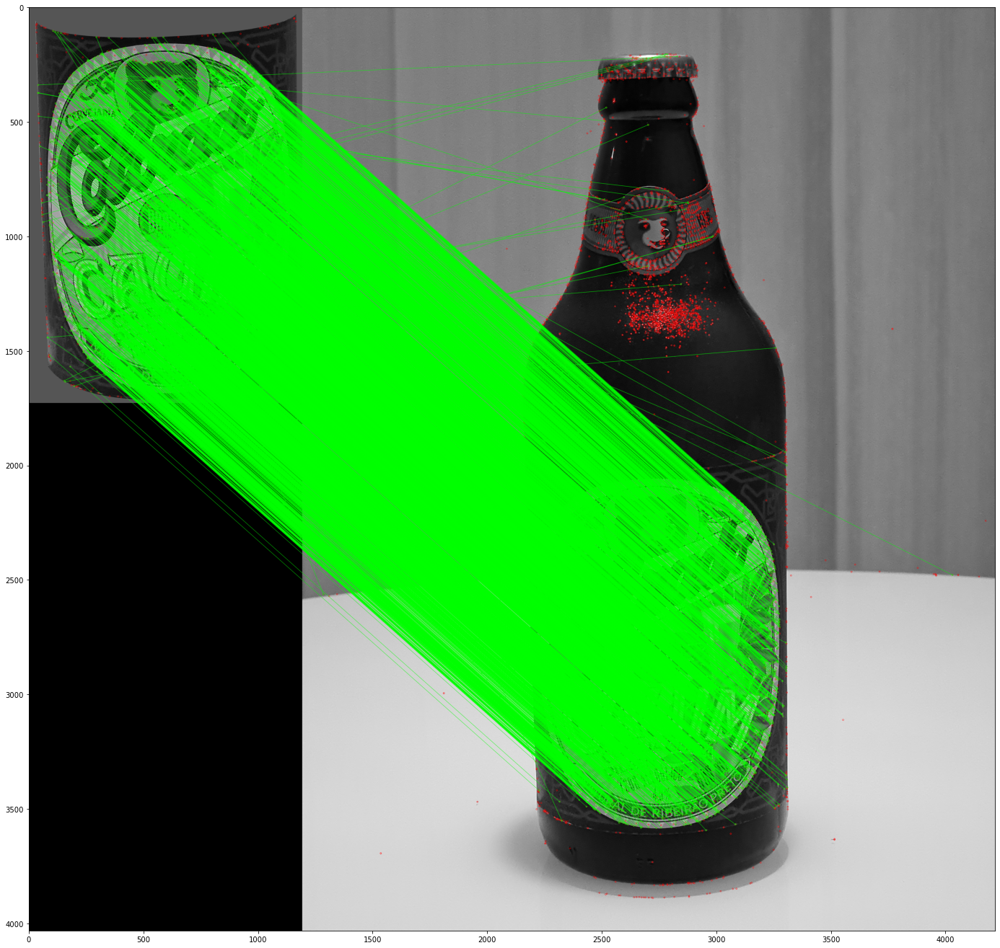

In [14]:
matches_not_null = [x for x in matches_knn_with_cc if x != []]
max_distance = max([m[0].distance for m in matches_not_null])

matches_knn_with_cc_filtered = [x for x in matches_not_null if x[0].distance < 0.6*max_distance] 

img_result = cv2.drawMatchesKnn(label, keypoints_label, img_scene, keypoints_scene, 
                          matches_knn_with_cc_filtered, None, matchColor=(0, 255, 0), matchesMask=None,
                          singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(img_result)

print("Without Good Distance: " + str(len(matches_not_null)))
print("With Good Distance: " + str(len(matches_knn_with_cc_filtered)))

#### NG Images - Brute Force with KNN With Crosscheck and Filtering by distance with max distance ratio

Without Good Distance: 948
With Good Distance: 523


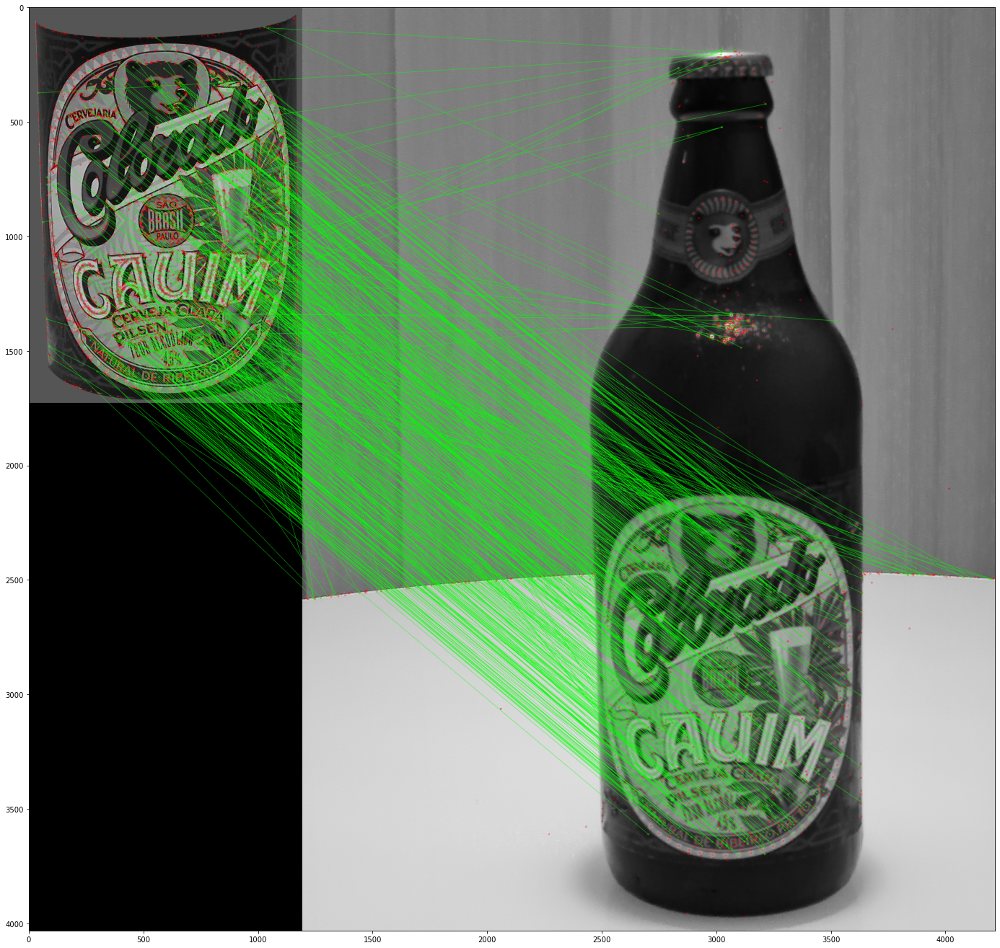

In [15]:
ng_matches_not_null = [x for x in ng_matches_knn_with_cc if x != []]
ng_max_distance = max([m[0].distance for m in ng_matches_not_null])

ng_matches_knn_with_cc_filtered = [x for x in ng_matches_not_null if x[0].distance < 0.6*ng_max_distance] 

ng_img_result = cv2.drawMatchesKnn(label, keypoints_label, ng_img_scene, ng_keypoints_scene, 
                                   ng_matches_knn_with_cc_filtered, None, matchColor=(0, 255, 0), matchesMask=None,
                                   singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(ng_img_result)

print("Without Good Distance: " + str(len(ng_matches_not_null)))
print("With Good Distance: " + str(len(ng_matches_knn_with_cc_filtered)))

#### Brute Force With KNN and Filtered by Lowe's ratio test

Quantity of good matches: 6038


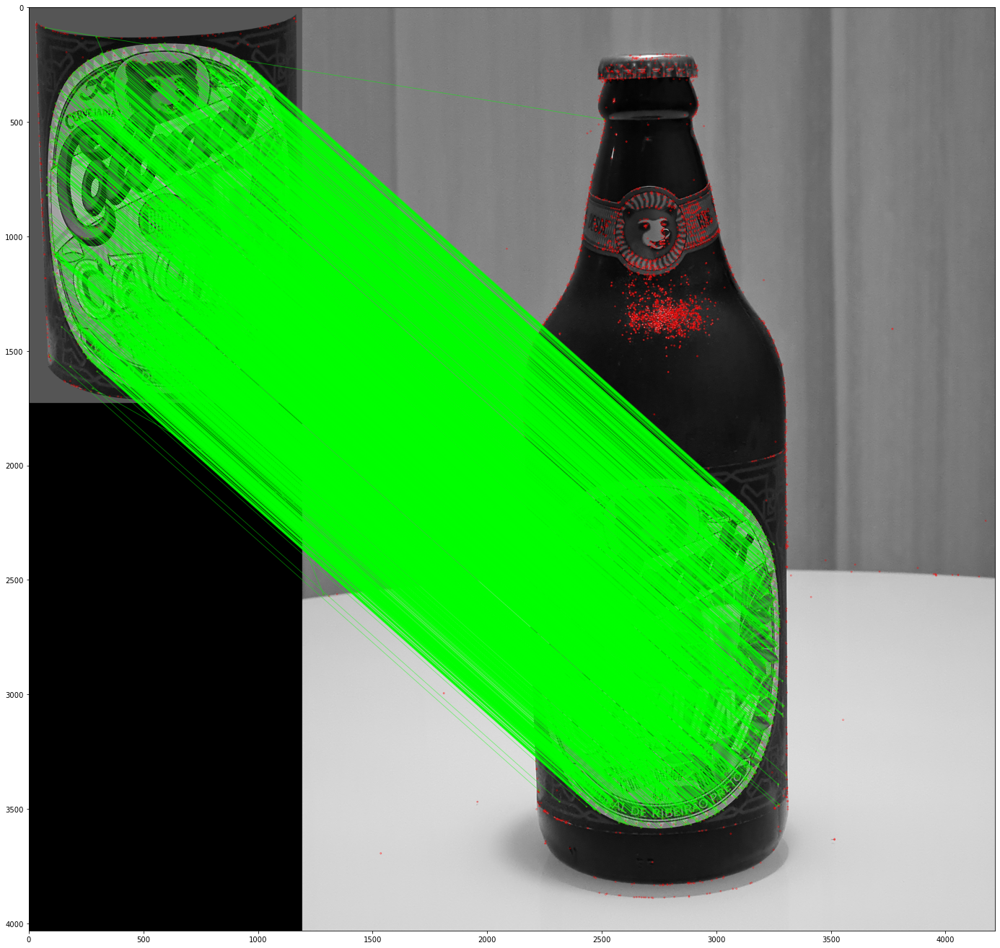

In [16]:
p_TwoSidesCheck = False
p_QuantitiesOfTheBestMatchings = 2

matcher = cv2.BFMatcher(crossCheck = p_TwoSidesCheck)
matches = matcher.knnMatch(descriptors_label, descriptors_scene, k = p_QuantitiesOfTheBestMatchings)

good_matches = []
for m1, m2 in matches:
    closest_kp_distance = m1.distance
    second_closest_kp_distance = m2.distance
    if closest_kp_distance/second_closest_kp_distance < 0.7:
        good_matches.append(m1)

img_result = cv2.drawMatches(label, keypoints_label, img_scene, keypoints_scene, 
                             good_matches, None, matchColor=(0, 255, 0), matchesMask=None,
                             singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(img_result)

print("Quantity of good matches: " + str(len(good_matches)))

#### NG Images - Brute Force With KNN and Filtered by Lowe's ratio test

Quantity of good matches: 404


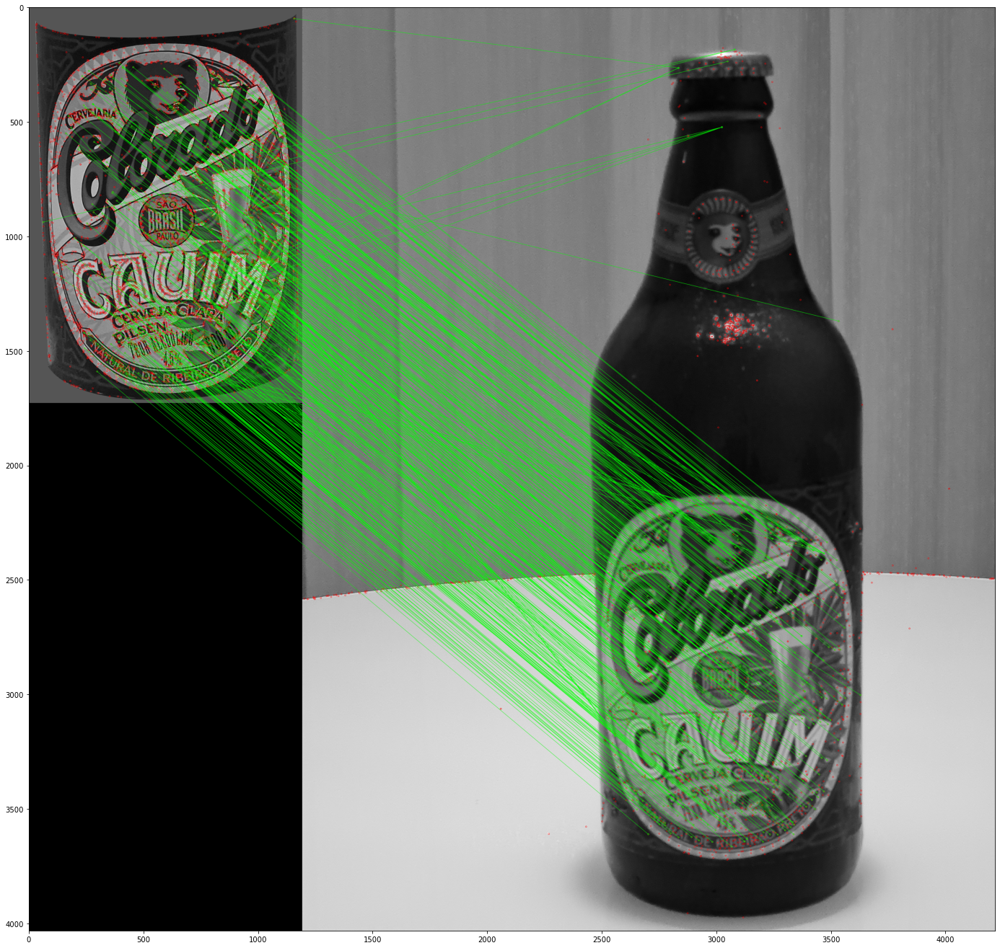

In [17]:
matches = matcher.knnMatch(descriptors_label, ng_descriptors_scene, k = p_QuantitiesOfTheBestMatchings)

ng_good_matches = []
for m1, m2 in matches:
    ng_closest_kp_distance = m1.distance
    ng_second_closest_kp_distance = m2.distance
    if ng_closest_kp_distance/ng_second_closest_kp_distance < 0.7:
        ng_good_matches.append(m1)

ng_img_result = cv2.drawMatches(label, keypoints_label, ng_img_scene, ng_keypoints_scene, 
                                ng_good_matches, None, matchColor=(0, 255, 0), matchesMask=None,
                                singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(ng_img_result)

print("Quantity of good matches: " + str(len(ng_good_matches)))

### Identify transformation to indicate inlier points

In [18]:
# Verify with anothers type of matches
matches_to_find = matches_knn_without_cc
matches_to_find = matches_knn_with_cc
matches_to_find = good_matches

if type(matches_to_find[0]) is list:
    matches_to_find_plain = []
    for m in matches_to_find:
        if type(m) is list:
            for n in m:
                matches_to_find_plain.append(n)
            
    matches_to_find = matches_to_find_plain
    
# Get positions of matching keypoints
keypoints_label_pos = np.zeros([len(matches_to_find), 2], dtype=np.float32)
keypoints_scene_pos = np.zeros([len(matches_to_find), 2], dtype=np.float32)

for i, m in enumerate(matches_to_find):
    keypoints_label_pos[i] = keypoints_label[m.queryIdx].pt
    keypoints_scene_pos[i] = keypoints_scene[m.trainIdx].pt
    
# T is the transformation matrix, mask is a boolean array indicating inlier points
T, mask = cv2.findHomography(keypoints_label_pos, keypoints_scene_pos, 
                             cv2.RANSAC, ransacReprojThreshold=3.0) 
matchesMask = mask.ravel().tolist()

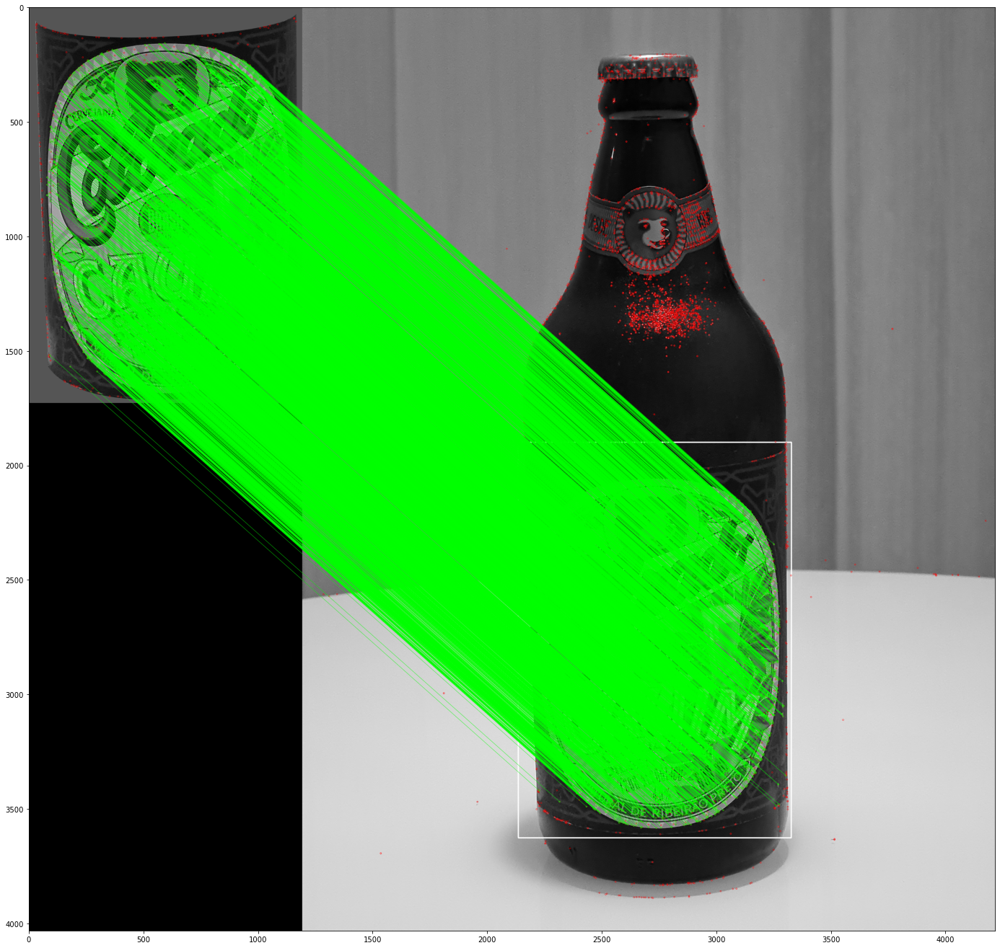

In [19]:
# Find transformation of rectangle delimiting object
h, w = label.shape
label_bounds = np.float32([[0,0], [0,h-1], [w-1,h-1], [w-1,0] ]).reshape(-1,1,2)
label_bounds_in_scene = cv2.perspectiveTransform(label_bounds, T)

# Draw polygon in the scene
img_scene_box = cv2.polylines(img_scene.copy(), [np.int32(label_bounds_in_scene)], True, 255, 3, cv2.LINE_AA)

img_matches_RANSAC = cv2.drawMatches(label, keypoints_label, img_scene_box, keypoints_scene, 
                                     matches_to_find, None, matchColor=(0, 255, 0), matchesMask=matchesMask,
                                     singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(img_matches_RANSAC, 'gray')

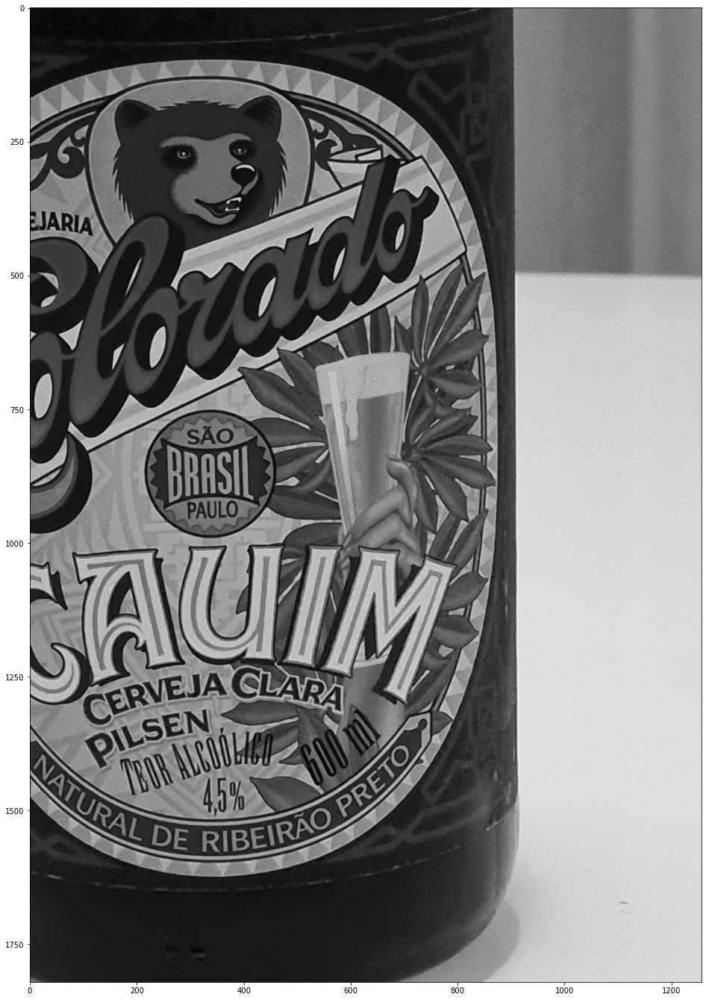

In [49]:
rect = cv2.boundingRect(label_bounds_in_scene)
x,y,w,h = rect
ok_box = img_scene[y:y+h, x:x+w].copy()

plt.figure(figsize=[24,24])
plt.imshow(ok_box, 'gray')

### NG Images - Identify transformation to indicate inlier points

In [21]:
# Verify with anothers type of matches
matches_to_find = ng_matches_knn_without_cc
matches_to_find = ng_matches_knn_with_cc
matches_to_find = ng_good_matches

if type(matches_to_find[0]) is list:
    matches_to_find_plain = []
    for m in matches_to_find:
        if type(m) is list:
            for n in m:
                matches_to_find_plain.append(n)
            
    matches_to_find = matches_to_find_plain
    
# Get positions of matching keypoints
keypoints_label_pos = np.zeros([len(matches_to_find), 2], dtype=np.float32)
keypoints_scene_pos = np.zeros([len(matches_to_find), 2], dtype=np.float32)

for i, m in enumerate(matches_to_find):
    keypoints_label_pos[i] = keypoints_label[m.queryIdx].pt
    keypoints_scene_pos[i] = ng_keypoints_scene[m.trainIdx].pt
    
# T is the transformation matrix, mask is a boolean array indicating inlier points
T, mask = cv2.findHomography(keypoints_label_pos, keypoints_scene_pos, 
                             cv2.RANSAC, ransacReprojThreshold=3.0) 
matchesMask = mask.ravel().tolist()

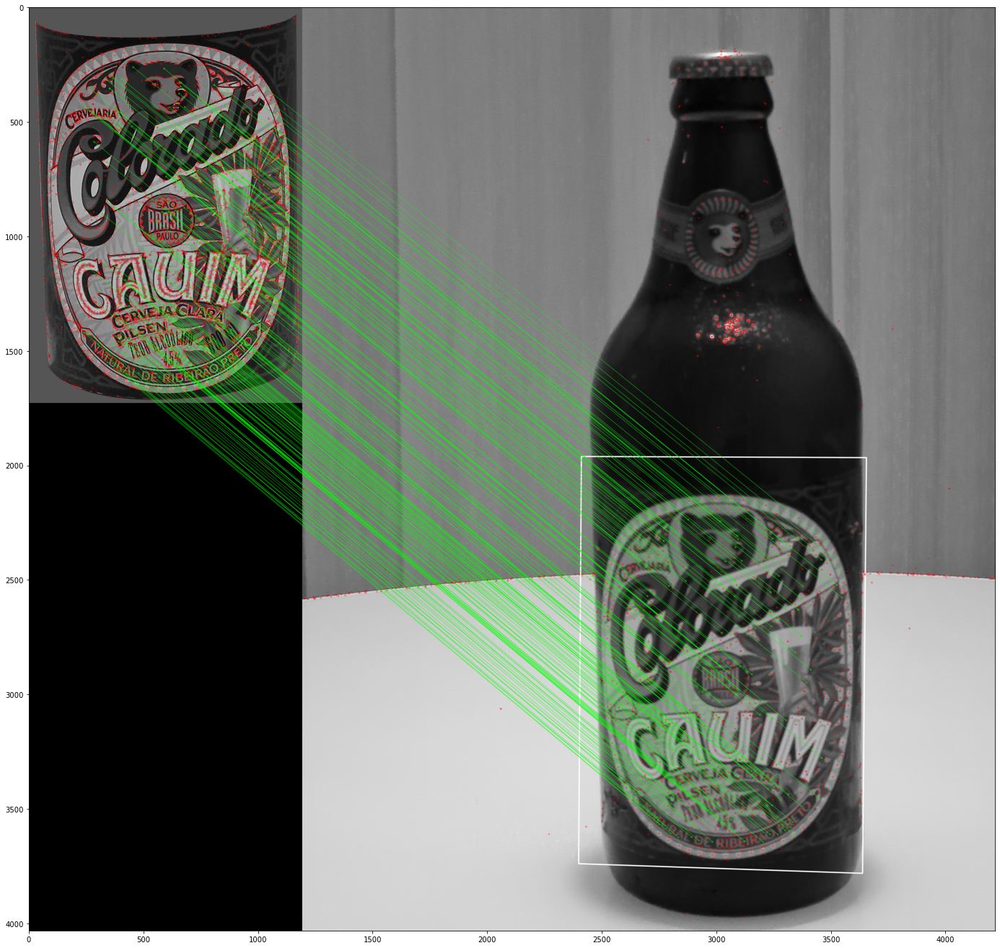

In [22]:
# Find transformation of rectangle delimiting object
h, w = label.shape
label_bounds = np.float32([[0,0], [0,h-1], [w-1,h-1], [w-1,0] ]).reshape(-1,1,2)
label_bounds_in_scene = cv2.perspectiveTransform(label_bounds, T)

# Draw polygon in the scene
ng_img_scene_box = cv2.polylines(ng_img_scene.copy(), [np.int32(label_bounds_in_scene)], True, 255, 3, cv2.LINE_AA)

ng_img_matches_RANSAC = cv2.drawMatches(label, keypoints_label, ng_img_scene_box, ng_keypoints_scene, 
                                     matches_to_find, None, matchColor=(0, 255, 0), matchesMask=matchesMask,
                                     singlePointColor=(255, 0, 0), flags=0)

plt.figure(figsize=[24,24])
plt.imshow(ng_img_matches_RANSAC, 'gray')

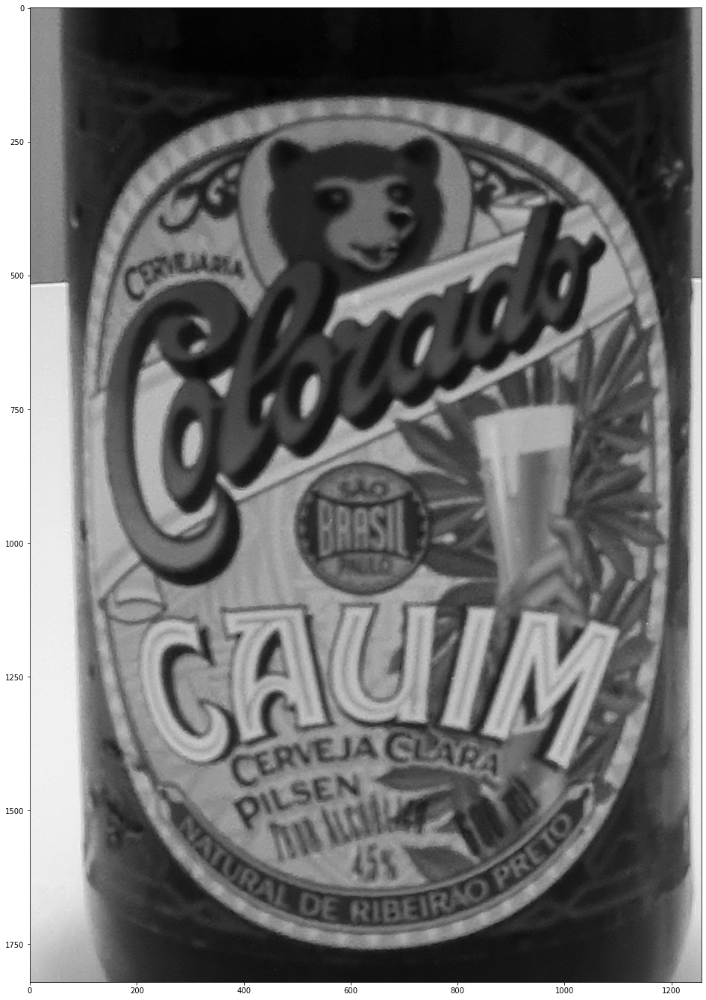

In [48]:
rect = cv2.boundingRect(label_bounds_in_scene)
x,y,w,h = rect
ng_box = ng_img_scene[y:y+h, x:x+w].copy()

plt.figure(figsize=[24,24])
plt.imshow(ng_box, 'gray')

In [24]:
print(ok_box.shape)
print(ng_box.shape)

(1728, 1193)
(1821, 1256)


In [25]:
xy = (max([ok_box.shape[1], ng_box.shape[1]]), max([ok_box.shape[0], ng_box.shape[0]]))

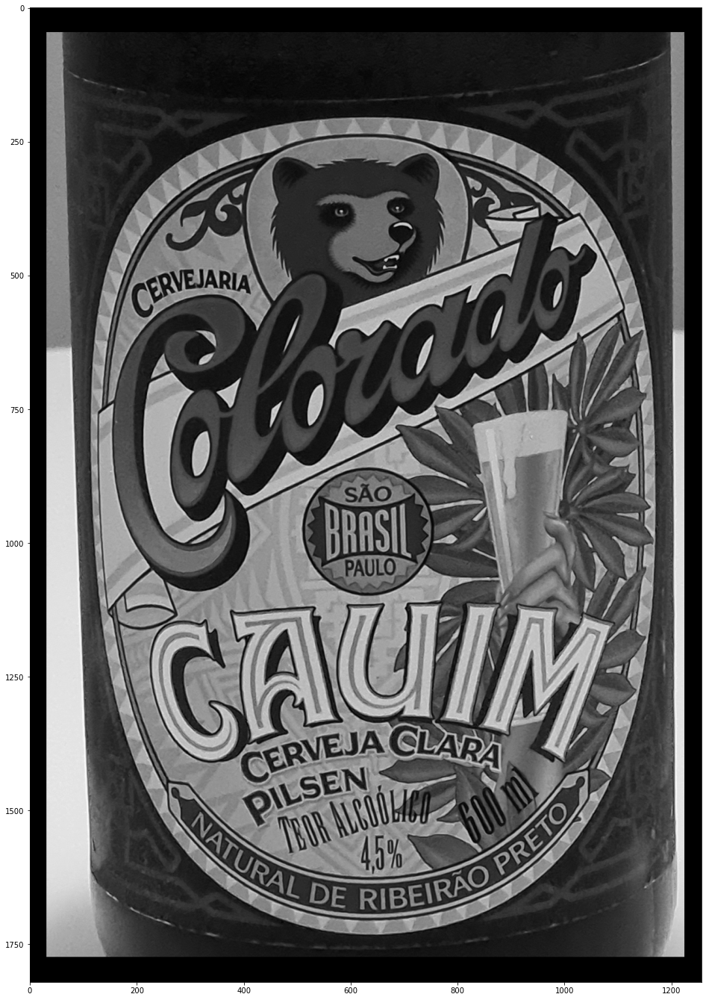

In [28]:
# find center
x_center = (xy[0] - ok_box.shape[1]) // 2
y_center = (xy[1] - ok_box.shape[0]) // 2

# initialize with zeros and copy image into the center
ok_box_resized  = np.zeros((xy[1], xy[0]))
ok_box_resized[y_center:y_center+ok_box.shape[0], 
               x_center:x_center+ok_box.shape[1]] = ok_box

plt.figure(figsize=[24,24])
plt.imshow(ok_box_resized, 'gray')

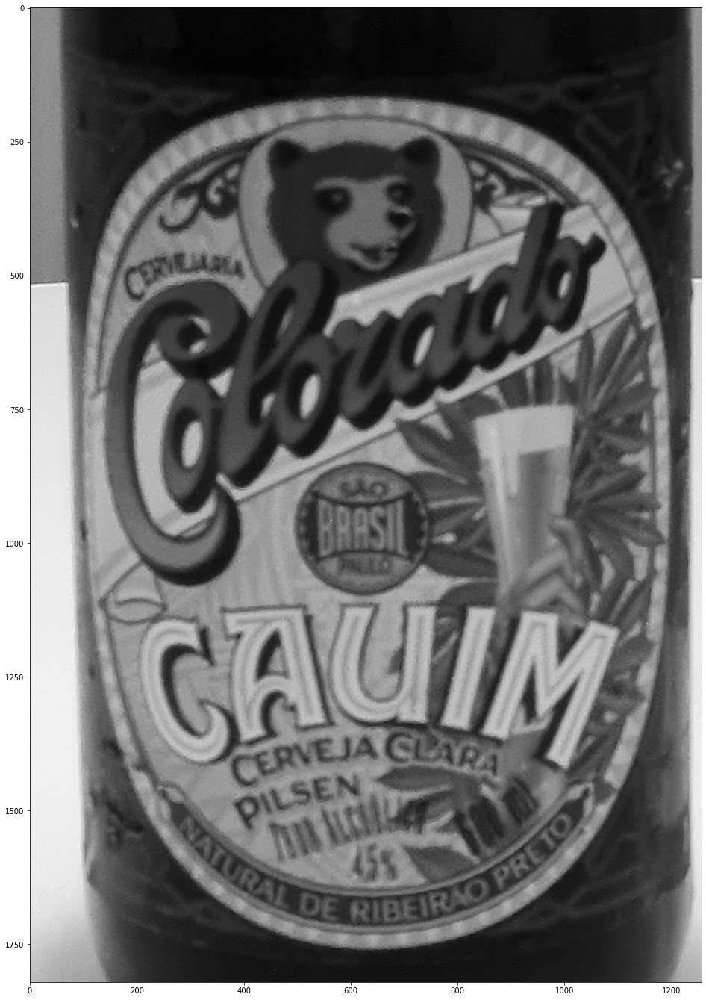

In [29]:
# find center
x_center = (xy[0] - ng_box.shape[1]) // 2
y_center = (xy[1] - ng_box.shape[0]) // 2

# initialize with zeros and copy image into the center
ng_box_resized  = np.zeros((xy[1], xy[0]))
ng_box_resized[y_center:y_center+ng_box.shape[0], 
               x_center:x_center+ng_box.shape[1]] = ng_box

plt.figure(figsize=[24,24])
plt.imshow(ng_box_resized, 'gray')

In [30]:
# aligned matrices
print(ng_box_resized.shape)
print(ok_box_resized.shape)

(1821, 1256)
(1821, 1256)


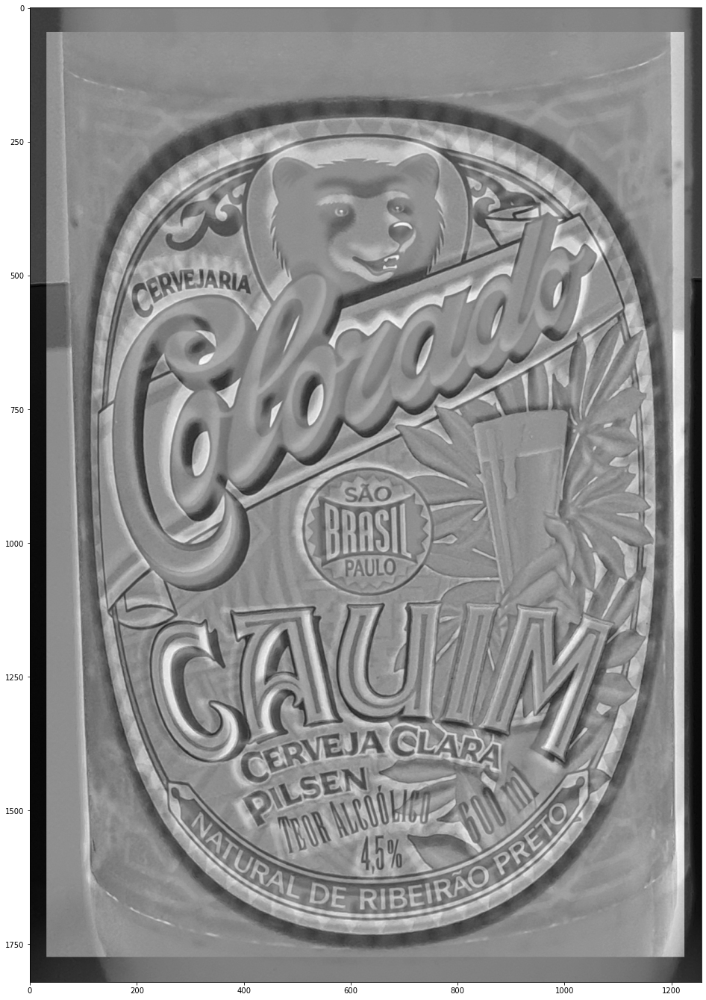

In [39]:
img_difference = cv2.subtract(ok_box_resized, ng_box_resized)

plt.figure(figsize=[24,24])
plt.imshow(img_difference, 'gray')

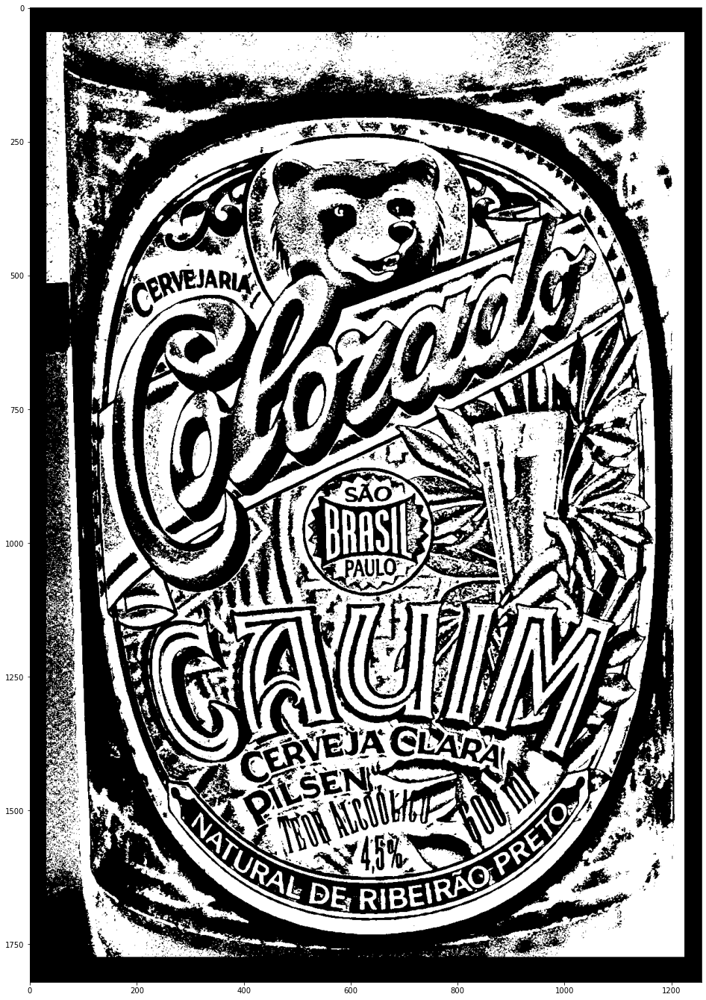

In [68]:
img_difference = ok_box_resized - ng_box_resized

threshold = 0
img_difference[img_difference >= threshold] = 255
img_difference[img_difference < threshold] = 0


plt.figure(figsize=[24,24])
plt.imshow(img_difference, 'gray')